In [1]:
import pandas as pd
import numpy as np
import seaborn as sb
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('../Project/Airbnb_US1')
df

C:\Users\91797\AppData\Local\Temp\ipykernel_5312\2462309367.py:1: DtypeWarning: Columns (25) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('../Project/Airbnb_US1')


,id,NAME,host_id,host_identity_verified,host_name,neighbourhood_group,neighbourhood,lat,long,country,...,service_fee,min_nights,number_of_reviews,last_review,reviews_per_month,review_rate_number,calculated_host_listings_count,availability_365,house_rules,license
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,...,193,10,9,2021-10-19,0,4,6,286,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,...,28,30,45,2022-05-21,0,4,2,228,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,unconfirmed,Elise,Manhattan,Harlem,40.80902,-73.94190,United States,...,124,3,0,NaN,0,5,1,352,"I encourage you to use my kitchen, cooking and...",NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,...,74,30,270,2019-05-07,4,4,1,322,Not Specified,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.79851,-73.94399,United States,...,41,10,9,2018-11-19,0,3,1,289,"Please no smoking in the house, porch or on th...",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102594,6092437,Spare room in Williamsburg,12312296767,verified,Krik,Brooklyn,Williamsburg,40.70862,-73.94651,United States,...,169,1,0,NaN,0,3,1,227,No Smoking No Parties or Events of any kind Pl...,NaN
102595,6092990,Best Location near Columbia U,77864383453,unconfirmed,Mifan,Manhattan,Morningside Heights,40.80460,-73.96545,United States,...,167,1,1,2015-06-07,0,2,2,395,House rules: Guests agree to the following ter...,NaN
102596,6093542,"Comfy, bright room in Brooklyn",69050334417,unconfirmed,Megan,Brooklyn,Park Slope,40.67505,-73.98045,United States,...,198,3,0,NaN,0,5,1,342,Not Specified,NaN
102597,6094094,Big Studio-One Stop from Midtown,11160591270,unconfirmed,Christopher,Queens,Long Island City,40.74989,-73.93777,United States,...,109,2,5,2015-11-10,0,3,1,386,Not Specified,NaN


In [3]:
df.drop(df.loc[df['NAME'].isnull()].index.tolist(),inplace=True)

In [4]:
df.groupby('NAME')['number_of_reviews'].sum().nlargest(10)

NAME
Cozy Room Family Home LGA Airport NO CLEANING FEE     2040
THE PRIVACY DEN ~ 5 MINUTES TO JFK                    2000
5 minutes from JFK,one single cozy bedroom for one    1812
Sun Room Family Home LGA Airport NO CLEANING FEE      1668
Private room near LGA Airport with queen bed          1610
Peaches Paradise.                                     1585
Cozy Room Close to JFK!!                              1568
Private Bedroom in Manhattan                          1557
Queen bed-Close to Columbia U & Central Park          1519
My Little Guest Room in Flushing                      1498
Name: number_of_reviews, dtype: int64

In [5]:
df.NAME.value_counts().nlargest(10)

NAME
Home away from home                  33
Water View King Bed Hotel Room       30
Hillside Hotel                       30
New york Multi-unit building         27
Brooklyn Apartment                   27
Private Room                         23
Cozy Brooklyn Apartment              20
Private room in Brooklyn             19
Cozy home away from home             18
Beautiful 2 Double Bed Hotel Room    18
Name: count, dtype: int64

In [6]:
df.neighbourhood_group.value_counts()

neighbourhood_group
Manhattan        43696
Brooklyn         41733
Queens           13241
Bronx             2705
Staten Island      954
Name: count, dtype: int64

In [7]:
df.neighbourhood.value_counts().nlargest(10)

neighbourhood
Bedford-Stuyvesant    7914
Williamsburg          7736
Harlem                5445
Bushwick              4971
Hell's Kitchen        3954
Upper West Side       3853
Upper East Side       3675
East Village          3486
Midtown               3386
Crown Heights         3255
Name: count, dtype: int64

In [8]:
df.groupby('neighbourhood_group')['price'].sum()

neighbourhood_group
Bronx             1694035
Brooklyn         26088114
Manhattan        27132070
Queens            8325700
Staten Island      594360
Name: price, dtype: int64

In [9]:
df.groupby('neighbourhood')['price'].sum()

neighbourhood
Allerton             61089
Arden Heights         7244
Arrochar             31914
Arverne             145424
Astoria            1193212
                    ...   
Windsor Terrace     191329
Woodhaven           120319
Woodlawn             17027
Woodrow               2128
Woodside            368784
Name: price, Length: 225, dtype: int64

In [10]:
df.groupby('host_id')['id'].count().sort_values(ascending=False).head(10)

host_id
90853100801    2
38877087869    2
32736284559    2
72628765617    2
40460149489    2
32741381728    2
61210811059    2
32108646910    2
52111041287    2
69050334417    2
Name: id, dtype: int64

In [11]:
df.groupby('host_id')['price'].mean().reset_index()

,host_id,price
0,123600518,694.0
1,124039648,548.0
2,124472619,779.0
3,129756565,1170.0
4,130349612,684.0
...,...,...
101783,98758136270,175.0
101784,98760968631,637.0
101785,98762661810,1156.0
101786,98762683230,904.0


In [12]:
a = df.groupby('neighbourhood_group')['availability_365'].mean().reset_index()
a

,neighbourhood_group,availability_365
0,Bronx,177.849538
1,Brooklyn,129.269691
2,Manhattan,141.586461
3,Queens,161.100597
4,Staten Island,197.085954


In [13]:
df.groupby('neighbourhood')['service_fee'].mean().nlargest(10)

neighbourhood
New Dorp                  209.250000
Chelsea, Staten Island    208.000000
Fort Wadsworth            205.000000
Little Neck               163.500000
Jamaica Hills             162.571429
Arden Heights             161.000000
Midland Beach             159.176471
Shore Acres               158.434783
Mill Basin                155.142857
Riverdale                 153.842105
Name: service_fee, dtype: float64

In [14]:
df.groupby('neighbourhood')['reviews_per_month'].mean().sort_values(ascending = False).nlargest(10)

neighbourhood
East Elmhurst             3.654244
Glen Oaks                 3.500000
Huguenot                  3.111111
Springfield Gardens       3.093117
Chelsea, Staten Island    3.000000
Gerritsen Beach           3.000000
Silver Lake               3.000000
Rosebank                  2.714286
South Ozone Park          2.370079
Schuylerville             2.085106
Name: reviews_per_month, dtype: float64

['Brooklyn' 'Manhattan' 'Queens' 'Staten Island' 'Bronx']


Enter neighbourhood_group =  Queens


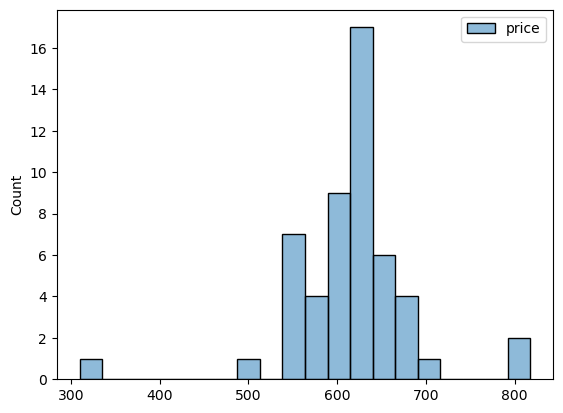

In [15]:
print(df.neighbourhood_group.unique())
ng = input('Enter neighbourhood_group = ')
result = df.groupby(['neighbourhood_group', 'neighbourhood'])['price'].mean().reset_index()
result1 = result[result['neighbourhood_group'] == ng]
sb.histplot(result1)
plt.show()

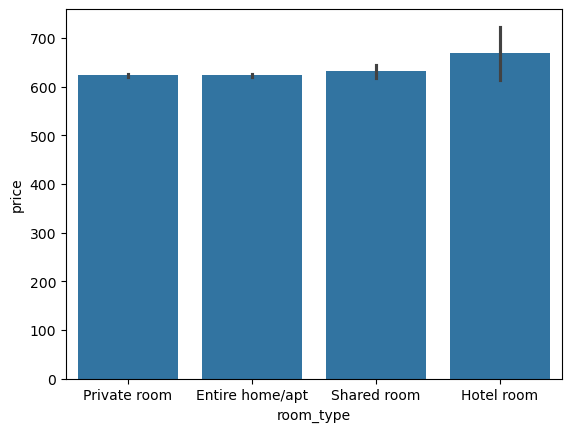

In [16]:
sb.barplot(x = df.room_type, y = df.price)
plt.show()

**Room Type Distribution:**

"Entire home/apt" is the most common type of listing, followed by "Private rooms."
"Shared rooms" and "Hotel rooms" are the least common, indicating lower demand for such accommodations.

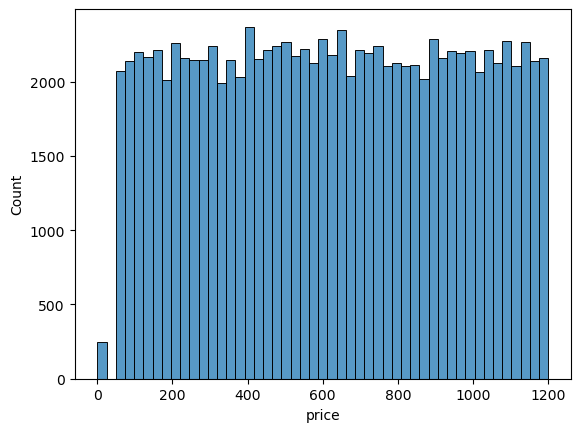

In [18]:
sb.histplot(df.price)
plt.show()

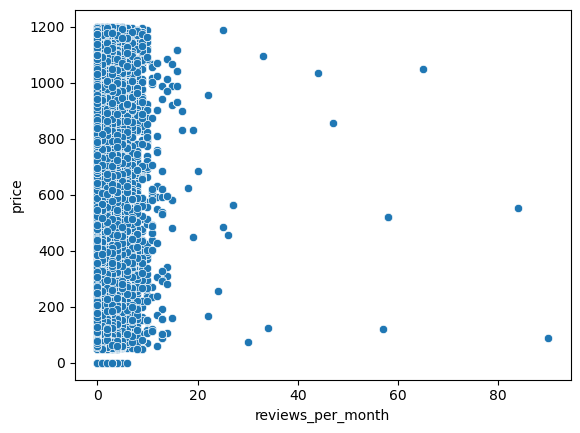

In [19]:
sb.scatterplot(x = df.reviews_per_month, y = df.price)
plt.show()

**Reviews vs. Price:**

No clear correlation between the number of reviews and price.
Budget-friendly listings tend to receive more reviews, while high-end listings cater to a niche audience.


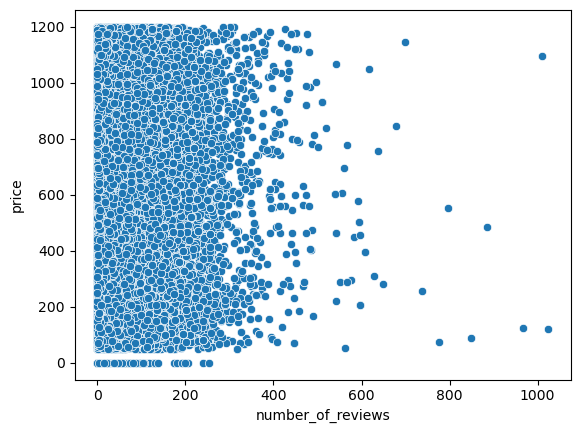

In [21]:
sb.scatterplot(x = df.number_of_reviews, y = df.price)
plt.show()

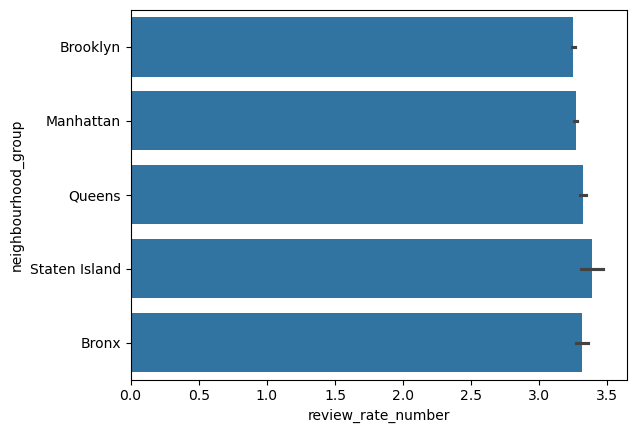

In [22]:
sb.barplot(x = df.review_rate_number, y = df.neighbourhood_group)
plt.show()

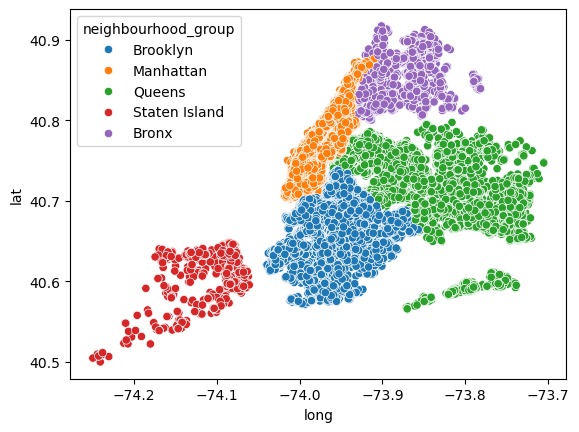

In [23]:
sb.scatterplot(x = df.long , y = df.lat, hue= df.neighbourhood_group)
plt.show()

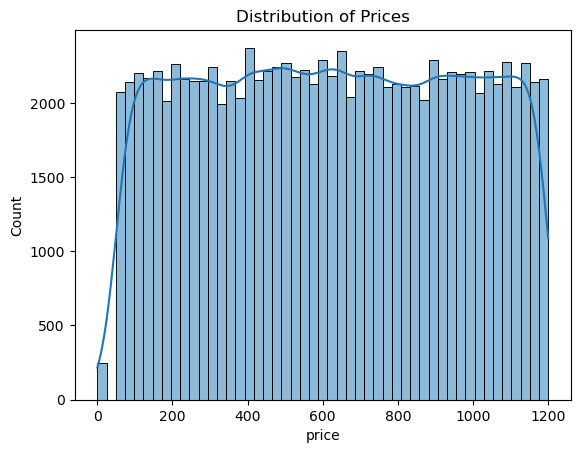

In [24]:
sb.histplot(df['price'], kde=True)
plt.title("Distribution of Prices")
plt.show()

**Price Distribution:**

Most Airbnb listings have prices concentrated at lower values.
A few high-priced listings exist, likely luxury properties or large accommodations.

In [26]:
import folium
from folium.plugins import MarkerCluster


In [27]:
import plotly.express as px

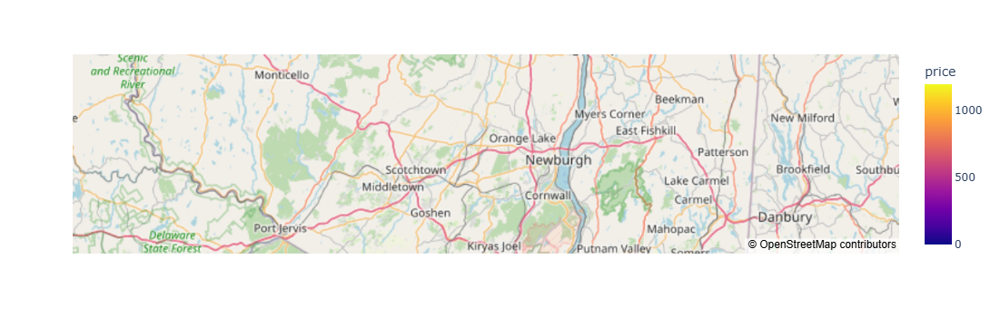

In [28]:
fig = px.scatter_mapbox(df, 
                         lat="lat", 
                         lon="long", 
                         hover_name="NAME", 
                         hover_data={"price": True, "room_type": True, "lat": False, "long": False},
                         color="price", 
                         size_max=25,
                         zoom=10, 
                         mapbox_style="open-street-map")

fig.show()

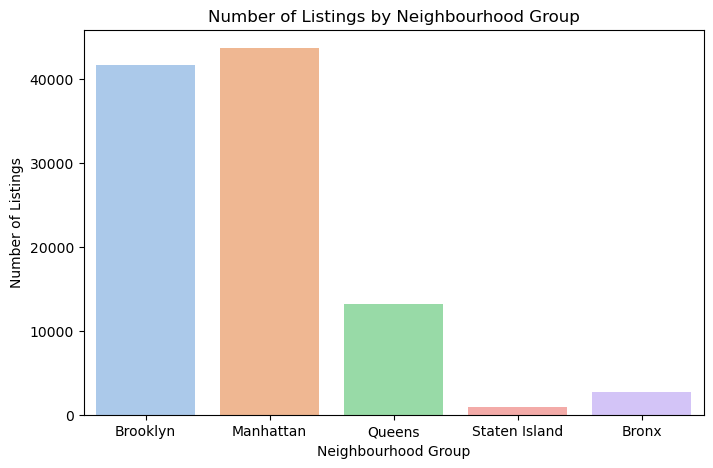

In [29]:
plt.figure(figsize=(8, 5))
sb.countplot(x='neighbourhood_group', data=df, hue=df.neighbourhood_group, palette='pastel')
plt.title('Number of Listings by Neighbourhood Group')
plt.xlabel('Neighbourhood Group')
plt.ylabel('Number of Listings')
plt.show()

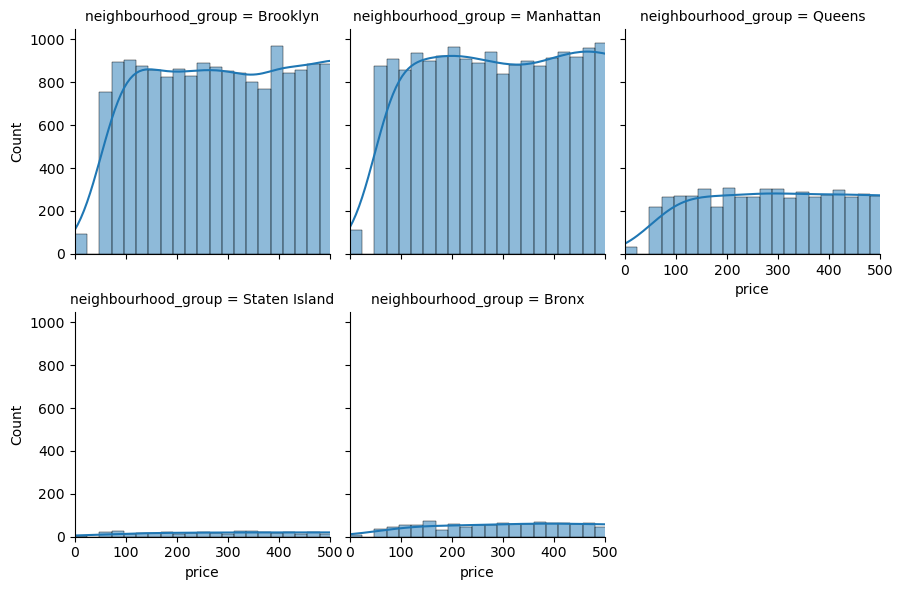

In [30]:
g = sb.FacetGrid(df, col="neighbourhood_group", col_wrap=3, sharex=True, sharey=True)
g.map(sb.histplot, "price", kde=True, bins=50)
plt.xlim(0, 500)
plt.show()

In [31]:
df.columns

Index(['id', 'NAME', 'host_id', 'host_identity_verified', 'host_name',
       'neighbourhood_group', 'neighbourhood', 'lat', 'long', 'country',
       'country_code', 'instant_bookable', 'cancellation_policy', 'room_type',
       'Construction_year', 'price', 'service_fee', 'min_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'review_rate_number', 'calculated_host_listings_count',
       'availability_365', 'house_rules', 'license'],
      dtype='object')